[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/constanzacaride/Emergencias/blob/main/3FOCOS24h.ipynb)

INPUTS:  
1- URL a FIRMS de donde se descargan en formato shapefile las anomalías térmicas (focos de calor) registradas por MODIS en Sudamérica durante las últimas 24hs.  
2- Regiones_Arg.shp (vector de polígonos con las regiones de Argentina).  

OUTPTS:  
1- Shapefile de puntos de las anomalías térmicas registradas en Argentina entre las 8:00AM del día de hoy y las 8:00AM de anteayer (48hs).  
2- Shapefile de puntos de las anomalías térmicas registradas en cada región de Argentina entre las 8:00AM del día de hoy y las 8:00AM de anteayer (48hs).   

RESUMEN DE PASOS DEL SCRIPT:  
- Descarga las anomalías térmicas de las últimas 24hs (MODIS 1km).   
- Filtra los que tienen confianza mayor a 80%.  
- Abre el shp de Regiones de Argentina.  
- Intersecta los focos con las Regiones.  
- Guarda los focos de toda Argentina.
- Guarda los focos para cada Región de Argentina de forma independiente.  


In [ ]:
#Instalo los paquetes que no están preinstaldos en colab
!pip install geopandas

In [ ]:
#Importo las librerias
from urllib.request import urlretrieve
from zipfile import ZipFile
import pandas as pd
import geopandas as gpd
import os
from datetime import datetime, timedelta

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#Defino la ruta (desde My Drive...) a la carpeta en la que se van a guardar los archivos de salida (la carpeta ya debe existir)
path_salidas = "/content/drive/MyDrive/" + input("/content/drive/MyDrive/ -> Escriba la carpeta o el path en el que va a trabajar: ")
print(path_salidas)

/content/drive/MyDrive/ -> Escriba la carpeta o el path en el que va a trabajar: Salidas
/content/drive/MyDrive/Salidas


In [ ]:
#Fecha actual
hoy = datetime.today().strftime('%Y-%m-%d')
print(hoy)

2025-01-16


In [ ]:
#Creo una carpeta salidas
os.mkdir(path_salidas + '/Focos'+ hoy)
path_focos = (path_salidas + '/Focos'+ hoy)
print(path_focos)

/content/drive/MyDrive/Salidas/Focos2025-01-16


In [ ]:
#Creo un archivo que registre la fecha y hora de procesamiento
fh = datetime.today() - timedelta(hours=3, minutes=0)
text_file = open(path_focos + '/0_Fecha-hora_procesamiento.txt', 'w')
my_string = str(fh)
text_file.write(my_string)
text_file.close()
print(fh)

2025-01-16 07:54:06.467365


In [ ]:
#Descargo el archivo zip
archivo_zipURL = "https://firms.modaps.eosdis.nasa.gov/data/active_fire/modis-c6.1/shapes/zips/MODIS_C6_1_South_America_24h.zip"
archivo_zip = "/content/focos.zip"
urlretrieve(archivo_zipURL, archivo_zip)
print("Archivo descargado con EXITO!")

Archivo descargado con EXITO!


In [ ]:
#Descomprimo el archivo zip
currentFileZip= ZipFile(archivo_zip)
currentFileZip.extractall("/content/")
currentFileZip.close()
print("Archivo deszipeado")

Archivo deszipeado


In [ ]:
#Abro el shapefile de focos
focos = gpd.read_file("/content/MODIS_C6_1_South_America_24h.shp")
focos

,LATITUDE,LONGITUDE,BRIGHTNESS,SCAN,TRACK,ACQ_DATE,ACQ_TIME,SATELLITE,CONFIDENCE,VERSION,BRIGHT_T31,FRP,DAYNIGHT,geometry
0,-2.51643,-51.91631,314.94,1.05,1.02,2025-01-15,0056,T,90,6.1NRT,291.14,12.50,N,POINT (-51.91631 -2.51643)
1,-2.51770,-51.92556,314.03,1.05,1.02,2025-01-15,0056,T,88,6.1NRT,289.93,11.73,N,POINT (-51.92556 -2.5177)
2,-22.10526,-49.63263,303.42,1.26,1.12,2025-01-15,0052,T,55,6.1NRT,292.60,7.04,N,POINT (-49.63263 -22.10526)
3,-2.50741,-51.91762,328.63,1.05,1.02,2025-01-15,0056,T,100,6.1NRT,292.04,27.31,N,POINT (-51.91762 -2.50741)
4,-21.74551,-50.82182,304.02,1.48,1.20,2025-01-15,0052,T,58,6.1NRT,293.96,7.90,N,POINT (-50.82182 -21.74551)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1199,-29.39881,-60.98096,317.26,1.19,1.09,2025-01-16,0624,A,95,6.1NRT,294.60,18.14,N,POINT (-60.98096 -29.39881)
1200,-29.48104,-61.68571,308.78,1.11,1.05,2025-01-16,0624,A,76,6.1NRT,290.47,10.00,N,POINT (-61.68571 -29.48104)
1201,-29.48253,-61.67443,307.17,1.11,1.05,2025-01-16,0624,A,71,6.1NRT,290.77,8.80,N,POINT (-61.67443 -29.48253)
1202,-30.15070,-58.47104,308.38,1.71,1.28,2025-01-16,0624,A,74,6.1NRT,292.55,18.00,N,POINT (-58.47104 -30.1507)


In [ ]:
#Veo en que proyección está
print(focos.crs)

EPSG:4326


In [ ]:
#Selecciono los focos que tienen una confianza mayor a 80%
focos80 = focos.loc[focos["CONFIDENCE"]>=80]
print(focos80.shape) #Para ver más o menos que % quedó
focos80.head()

(389, 14)


,LATITUDE,LONGITUDE,BRIGHTNESS,SCAN,TRACK,ACQ_DATE,ACQ_TIME,SATELLITE,CONFIDENCE,VERSION,BRIGHT_T31,FRP,DAYNIGHT,geometry
0,-2.51643,-51.91631,314.94,1.05,1.02,2025-01-15,0056,T,90,6.1NRT,291.14,12.50,N,POINT (-51.91631 -2.51643)
1,-2.51770,-51.92556,314.03,1.05,1.02,2025-01-15,0056,T,88,6.1NRT,289.93,11.73,N,POINT (-51.92556 -2.5177)
3,-2.50741,-51.91762,328.63,1.05,1.02,2025-01-15,0056,T,100,6.1NRT,292.04,27.31,N,POINT (-51.91762 -2.50741)
5,-2.50868,-51.92686,326.32,1.05,1.02,2025-01-15,0056,T,100,6.1NRT,291.57,24.49,N,POINT (-51.92686 -2.50868)
6,-21.45196,-48.60518,331.95,1.11,1.05,2025-01-15,0052,T,100,6.1NRT,292.67,35.73,N,POINT (-48.60518 -21.45196)


In [ ]:
#Puedo traer archivos que tenga en algún repositorio de github (para subirlos al git deben ser más chicos de 25M)
#Buscar la dirección .git del repositorio (ver imágen debajo)
#Una vez corrida la sentencia el repositorio se clona en la carpeta contenidos (ver la tabla de contenidos a la izquierda)
!git clone "https://github.com/constanzacaride/Emergencias.git"

Cloning into 'Emergencias'...
remote: Enumerating objects: 57, done.
remote: Counting objects: 100% (57/57), done.
remote: Compressing objects: 100% (51/51), done.
remote: Total 57 (delta 13), reused 0 (delta 0), pack-reused 0 (from 0)
Receiving objects: 100% (57/57), 18.06 MiB | 9.63 MiB/s, done.
Resolving deltas: 100% (13/13), done.


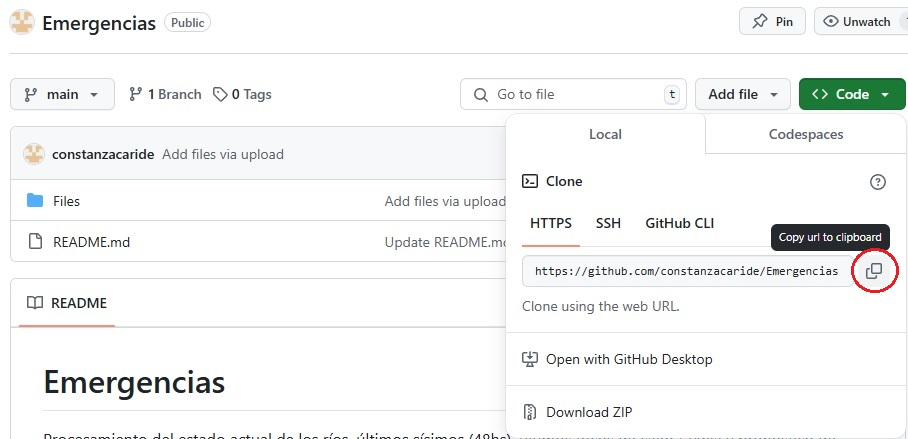

In [ ]:
#Descomprimo el archivo zip
currentFileZip= ZipFile("/content/Emergencias/Files/Regiones_Arg.zip") #El archivo está en formato kml
currentFileZip.extractall("/content/")
currentFileZip.close()
print("Archivo deszipeado")

Archivo deszipeado


In [ ]:
#Abro el shp de Regiones
arg = gpd.read_file("/content/Regiones_Arg.shp")
print(arg.crs) #Chequeo que sea la misma proyección que los focos
arg

EPSG:4326


,OBJECTID,Region,geometry
0,1,Centro,"MULTIPOLYGON (((-62.15339 -40.45148, -62.15339..."
1,2,Cuyo,"POLYGON ((-68.52136 -27.81792, -68.52148 -27.8..."
2,3,Litoral,"MULTIPOLYGON (((-56.86162 -27.59213, -56.86047..."
3,4,Noroeste,"POLYGON ((-66.20766 -21.78835, -66.19414 -21.7..."
4,5,Patagonia,"MULTIPOLYGON (((-59.80423 -80.34616, -59.8578 ..."


In [ ]:
#Hago una intersección
intersecArg = focos80.overlay(arg, how="intersection")
if intersecArg.empty == True:
  print("No hay focos con confianza mayor a 80 en territorio Argentino")
else:
  print(intersecArg.shape)

(90, 16)


In [ ]:
intersecArg.head()

,LATITUDE,LONGITUDE,BRIGHTNESS,SCAN,TRACK,ACQ_DATE,ACQ_TIME,SATELLITE,CONFIDENCE,VERSION,BRIGHT_T31,FRP,DAYNIGHT,OBJECTID,Region,geometry
0,-33.36688,-60.13883,325.93,1.07,1.03,2025-01-14,0147,T,100,6.1NRT,297.62,24.33,N,1,Centro,POINT (-60.13883 -33.36688)
1,-33.25854,-60.28713,312.15,1.08,1.04,2025-01-14,0147,T,84,6.1NRT,295.84,11.33,N,3,Litoral,POINT (-60.28713 -33.25854)
2,-31.95924,-59.53210,313.93,1.02,1.01,2025-01-14,0147,T,88,6.1NRT,293.44,13.25,N,3,Litoral,POINT (-59.5321 -31.95924)
3,-31.02608,-59.83987,312.50,1.02,1.01,2025-01-14,0147,T,85,6.1NRT,291.52,12.29,N,3,Litoral,POINT (-59.83987 -31.02608)
4,-29.67660,-61.55151,323.67,1.12,1.05,2025-01-14,0149,T,100,6.1NRT,293.73,24.09,N,3,Litoral,POINT (-61.55151 -29.6766)


In [ ]:
#Guardo los seleccionados
intersecArg.to_file(filename= path_focos + "/Focos_Arg.shp")

/usr/local/lib/python3.11/dist-packages/pyogrio/raw.py:723: RuntimeWarning: Field ACQ_DATE create as date field, though DateTime requested.
  ogr_write(


In [ ]:
#Genero una lista con los nombres de las brigadas
Reg= arg['Region'].unique()
Reg = list(Reg)
print(type(Reg))
Reg

<class 'list'>


['Centro', 'Cuyo', 'Litoral', 'Noroeste', 'Patagonia']

In [ ]:
#Guardo los puntos de cada Región en un shape independiente
for f in Reg:
  #focosReg[focosReg['Region']==f].to_file(filename= path_focos + "/Focos" + f + ".shp")
  intersecArg[intersecArg['Region']==f].to_file(filename= path_focos + "/Focos" + f + ".shp")

/usr/local/lib/python3.11/dist-packages/pyogrio/raw.py:723: RuntimeWarning: Field ACQ_DATE create as date field, though DateTime requested.
  ogr_write(
/usr/local/lib/python3.11/dist-packages/pyogrio/raw.py:723: RuntimeWarning: Field ACQ_DATE create as date field, though DateTime requested.
  ogr_write(
/usr/local/lib/python3.11/dist-packages/pyogrio/raw.py:723: RuntimeWarning: Field ACQ_DATE create as date field, though DateTime requested.
  ogr_write(
/usr/local/lib/python3.11/dist-packages/pyogrio/raw.py:723: RuntimeWarning: Field ACQ_DATE create as date field, though DateTime requested.
  ogr_write(
/usr/local/lib/python3.11/dist-packages/pyogrio/raw.py:723: RuntimeWarning: Field ACQ_DATE create as date field, though DateTime requested.
  ogr_write(
